In [8]:
import pandas as pd
import numpy as np
import matplotlib.pyplot as plt
import warnings
import math
warnings.filterwarnings("ignore")


# Construct Signal

## Shanon-Nyquist Theorem
**TODO**

In [9]:
# Parameters
fs = 120  # Sampling Frequency (Hz)
T = 1/fs  # seconds
N=200
t_samples = np.arange(0, N)  # sample indices
t_actual = t_samples / fs  # actual time in seconds

# Signal
comp1_freq_hz=10
comp2_freq_hz=5

noise_coeff=2

#Constuct signal
signal = (6 * np.sin(2*np.pi*comp1_freq_hz*t_actual) - 
          10 * np.cos(2*np.pi*comp2_freq_hz*t_actual) + 
          np.random.randn(len(t_actual)) * noise_coeff)

frequency_resolution = fs / N

freq_to_bin_func = lambda freq: freq / frequency_resolution


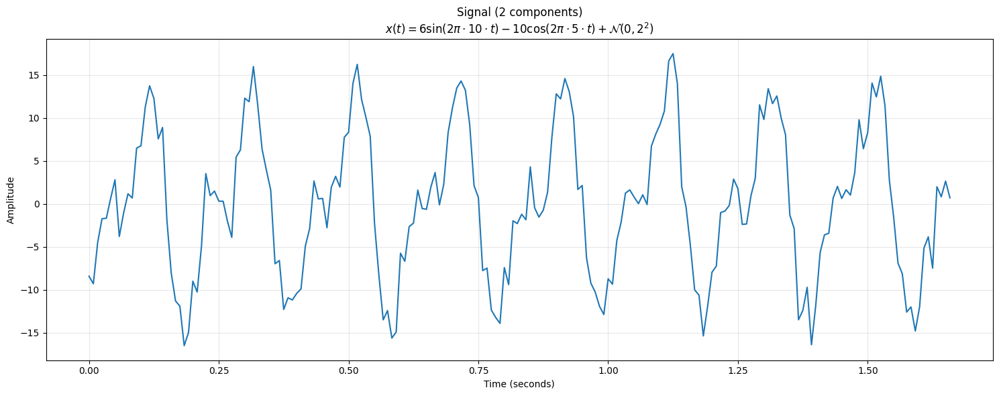

In [10]:
# Create formula string
formula = f"$x(t) = 6\sin(2\pi \cdot {comp1_freq_hz} \cdot t) - 10\cos(2\pi \cdot {comp2_freq_hz} \cdot t) + \mathcal{{N}}(0, {noise_coeff}^2)$"

# Plot
plt.figure(figsize=(15, 6))
plt.plot(t_actual, signal)
plt.title(f"Signal (2 components)\n{formula}", fontsize=12)
plt.xlabel('Time (seconds)')
plt.ylabel('Amplitude')
plt.grid(True, alpha=0.3)
plt.tight_layout()
plt.show()

# Fourier

## Sum of correlating signal for different frequencies

In [14]:
def plot_correlating_signal(signal, k, match=False):
    terms = []
    N = len(signal)
    
    for i in range(N):
        angle = 2 * math.pi * k * i / N
        term = signal[i] * (np.cos(angle) - 1j * np.sin(angle))
        terms.append(term)
    
    # Extract real and imaginary parts
    real_parts = [t.real for t in terms]
    imag_parts = [t.imag for t in terms]
    indices = list(range(N))
    
    # Calculate averages
    avg_real = np.mean(real_parts)
    avg_imag = np.mean(imag_parts)
    
    # Title color based on match flag
    title_color = 'red' if match else 'black'
    title_fontsize = 12 if match else 10
    
    # Plot
    plt.figure(figsize=(8, 6))
    
    # Plot real parts
    plt.subplot(2, 1, 1)
    plt.stem(indices, real_parts, basefmt=' ', label='Real contributions')
    plt.axhline(0, color='black', linewidth=0.5)
    plt.axhline(avg_real, color='red', linewidth=2, linestyle='--', label=f'Average = {avg_real:.2f}')
    plt.xlabel('Sample index (n)')
    plt.ylabel('Real part')
    plt.title(f'DFT bin k={k}: Real contributions', color=title_color, fontsize=title_fontsize)
    plt.grid(True, alpha=0.3)
    plt.ylim((-10, 10))
    plt.legend()
    
    # Plot imaginary parts
    plt.subplot(2, 1, 2)
    plt.stem(indices, imag_parts, basefmt=' ', label='Imaginary contributions')
    plt.axhline(0, color='black', linewidth=0.5)
    plt.axhline(avg_imag, color='red', linewidth=2, linestyle='--', label=f'Average = {avg_imag:.2f}')
    plt.xlabel('Sample index (n)')
    plt.ylabel('Imaginary part')
    plt.title(f'DFT bin k={k}: Imaginary contributions', color=title_color, fontsize=title_fontsize)
    plt.grid(True, alpha=0.3)
    plt.ylim((-10, 10))
    plt.legend()
    
    plt.tight_layout()
    plt.show()
    
    # Print sum
    total = sum(terms)
    print(f"X[{k}] = {total.real:.2f} + {total.imag:.2f}i")
    print(f"|X[{k}]| = {abs(total):.2f}")
    
    #return terms

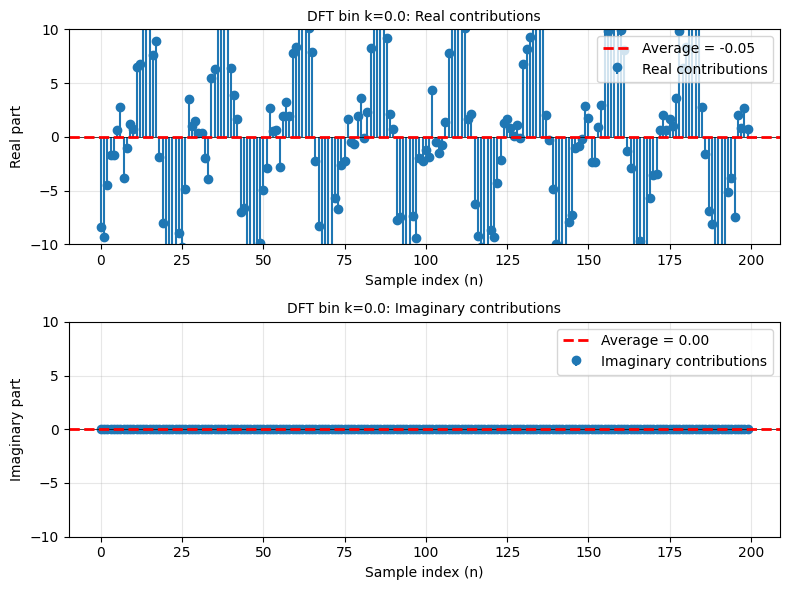

X[0.0] = -10.42 + 0.00i
|X[0.0]| = 10.42


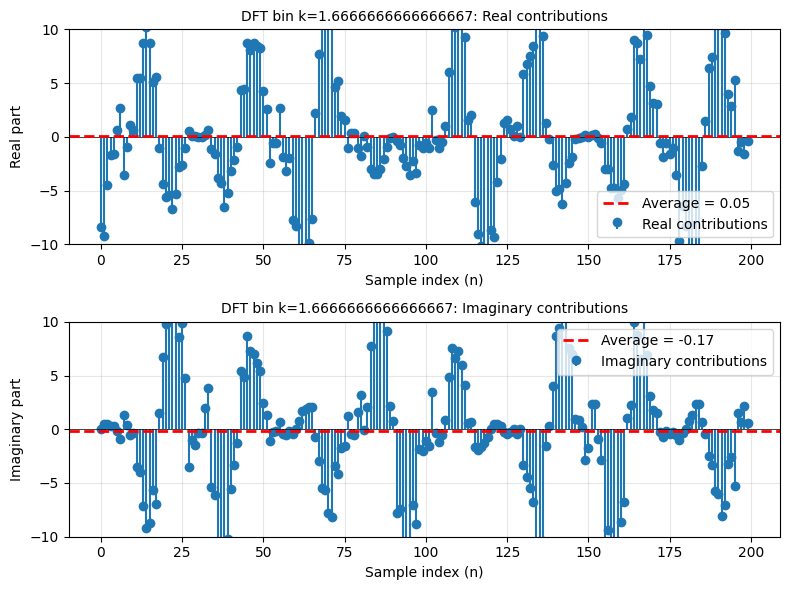

X[1.6666666666666667] = 10.26 + -33.78i
|X[1.6666666666666667]| = 35.30


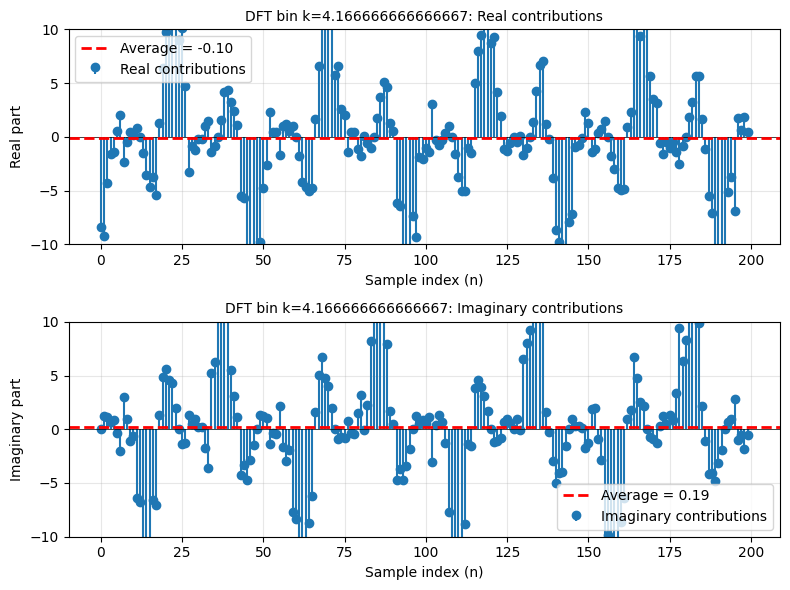

X[4.166666666666667] = -20.46 + 37.03i
|X[4.166666666666667]| = 42.31


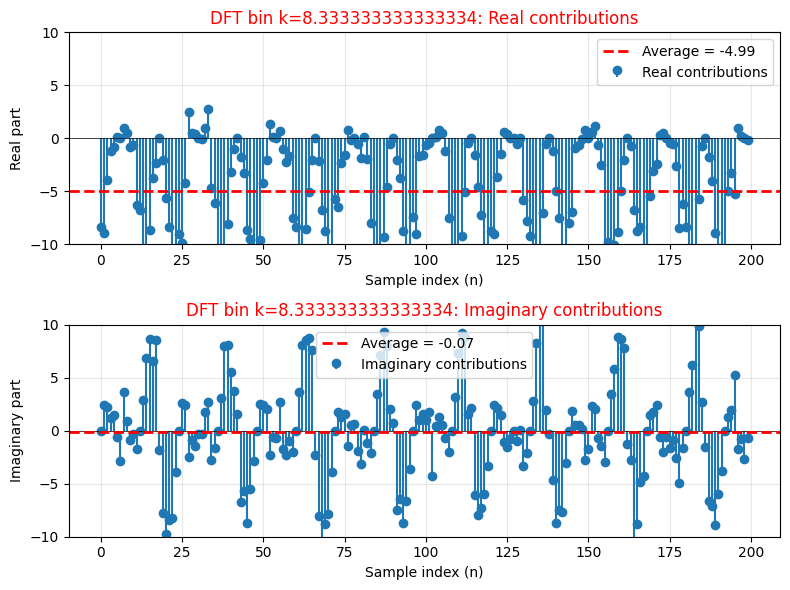

X[8.333333333333334] = -998.00 + -14.78i
|X[8.333333333333334]| = 998.11


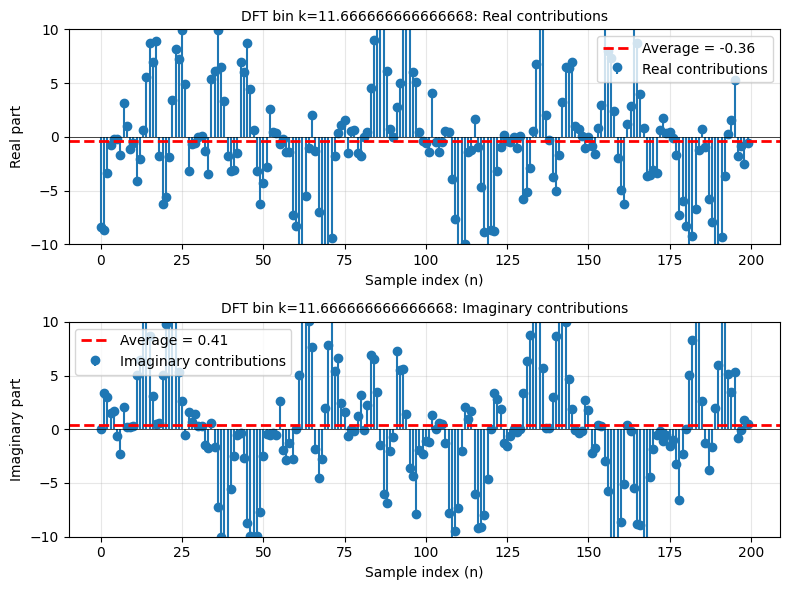

X[11.666666666666668] = -72.69 + 82.13i
|X[11.666666666666668]| = 109.68


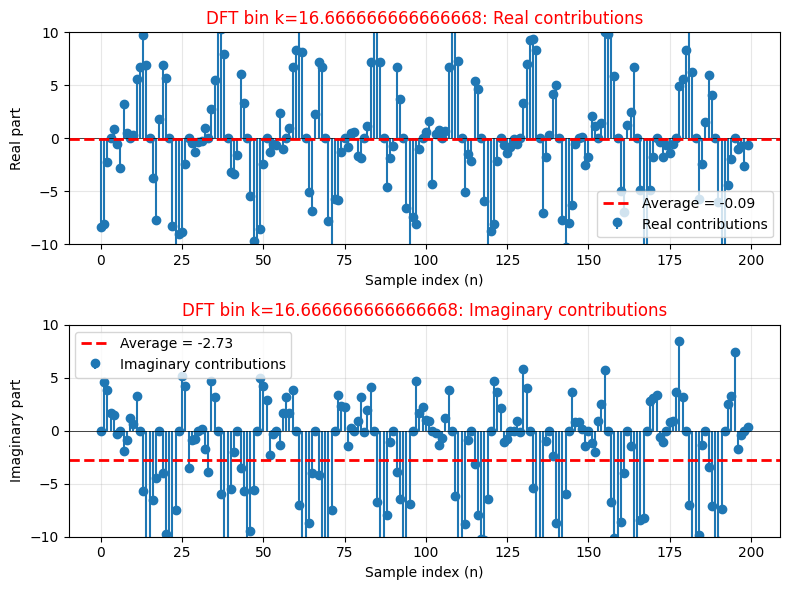

X[16.666666666666668] = -18.18 + -546.51i
|X[16.666666666666668]| = 546.81


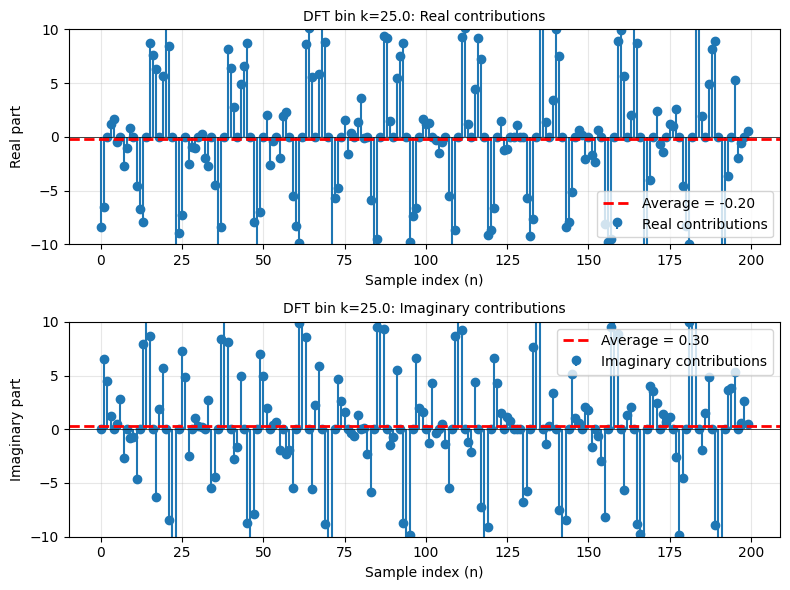

X[25.0] = -39.07 + 59.29i
|X[25.0]| = 71.01


In [15]:
#Now, plot correlating signal for some freqs

freqs = [0, 1, 2.5, 5, 7, 10, 15]

for f in freqs:
    plot_correlating_signal(signal, freq_to_bin_func(f), match=f in [comp1_freq_hz, comp2_freq_hz])

## Wrapping Signal on circle

In [16]:
from matplotlib.animation import FuncAnimation
from IPython.display import HTML
import matplotlib
matplotlib.rcParams['animation.embed_limit'] = 50 

def create_wrapping_animation(signal, freq_start, freq_end, num_frames=50, fs=40, plot_on_top="cos"):
    """
    Create an animation showing how signal wrapping changes as frequency varies.
    
    Parameters:
    - signal: the input signal
    - freq_start: starting frequency in Hz
    - freq_end: ending frequency in Hz
    - num_frames: number of frames in the animation
    - fs: sampling frequency
    - plot_on_top: either "cos" or "sin" to choose which wave to overlay
    """
    N = len(signal)
    frequency_resolution = fs / N
    t = np.arange(N) / fs
    
    # Create frequency range
    frequencies = np.linspace(freq_start, freq_end, num_frames)
    
    # Pre-calculate all magnitudes for the magnitude plot
    magnitudes = []
    for freq in frequencies:
        test_freq_bin = freq_to_bin_func(freq)
        actual_freq = test_freq_bin * frequency_resolution
        wrapping_signal = np.exp(-2j * np.pi * actual_freq * t)
        wrapped_points = signal * wrapping_signal
        center_of_gravity = np.mean(wrapped_points)
        magnitudes.append(np.abs(center_of_gravity))
    
    # Set up the figure with 3 subplots
    # Top row: circle (left) and magnitude (right)
    # Bottom row: signal (full width)
    fig = plt.figure(figsize=(16, 8))
    gs = fig.add_gridspec(2, 2, height_ratios=[2, 1])
    ax1 = fig.add_subplot(gs[0, 0])  # Top left: wrapped signal circle
    ax3 = fig.add_subplot(gs[0, 1])  # Top right: magnitude plot
    ax2 = fig.add_subplot(gs[1, :])  # Bottom: signal (spans both columns)
        
    def init():
        """Initialize the animation"""
        return []
    
    def update(frame):
        """Update function for each frame"""
        test_freq_hz = frequencies[frame]
        test_freq_bin = freq_to_bin_func(test_freq_hz)
        actual_freq = test_freq_bin * frequency_resolution
        
        # Clear axes
        ax1.clear()
        ax2.clear()
        ax3.clear()
        
        # Complex exponential for wrapping
        # these rotating coefficients - complex numbers
        # Multiplying real number by these coefficients have effect of rotating
        # by angle (-2π * actual_freq * t) clockwise
        wrapping_signal = np.exp(-2j * np.pi * actual_freq * t)
        wrapped_points = signal * wrapping_signal
        center_of_gravity = np.mean(wrapped_points)
        
        # TOP LEFT PLOT: Wrapped signal
        # Plot unit circle
        circle = plt.Circle((0, 0), 1, fill=False, color='gray', linestyle='--', alpha=0.3)
        ax1.add_patch(circle)
        
        # Plot wrapped signal path
        real_parts = wrapped_points.real
        imag_parts = wrapped_points.imag
        colors = plt.cm.viridis(np.linspace(0, 1, N))
        
        for i in range(N-1):
            ax1.plot([real_parts[i], real_parts[i+1]], 
                    [imag_parts[i], imag_parts[i+1]], 
                    color=colors[i], alpha=0.6, linewidth=1.5)
        
        ax1.scatter(real_parts, imag_parts, c=np.arange(N), 
                   cmap='viridis', s=50, alpha=0.7, edgecolors='black', linewidth=0.5)
        
        # Plot center of gravity
        ax1.scatter([0], [0], color='gray', s=100, marker='x', linewidths=2, label='Origin', zorder=5)
        ax1.scatter([center_of_gravity.real], [center_of_gravity.imag], 
                   color='red', s=200, marker='*', edgecolors='darkred', 
                   linewidth=2, label='Center of Gravity', zorder=10)
        
        # Arrow to center of gravity
        if np.abs(center_of_gravity) > 0.01:
            ax1.arrow(0, 0, center_of_gravity.real, center_of_gravity.imag, 
                     head_width=0.15, head_length=0.1, fc='red', ec='darkred', 
                     linewidth=2, alpha=0.7, zorder=9)
        
        # Formatting
        max_range = max(np.max(np.abs(real_parts)), np.max(np.abs(imag_parts)), 1.5)
        ax1.set_xlim(-max_range, max_range)
        ax1.set_ylim(-max_range, max_range)
        ax1.set_aspect('equal')
        ax1.axhline(y=0, color='k', linestyle='-', alpha=0.3, linewidth=0.5)
        ax1.axvline(x=0, color='k', linestyle='-', alpha=0.3, linewidth=0.5)
        ax1.grid(True, alpha=0.2)
        ax1.set_xlabel('Real Part', fontsize=11)
        ax1.set_ylabel('Imaginary Part', fontsize=11)
        
        # Add magnitude info to title
        magnitude = np.abs(center_of_gravity)
        ax1.set_title(f'Wrapped at {actual_freq:.2f} Hz (bin {test_freq_bin:.2f})\n' + 
                     f'CoG Magnitude: {magnitude:.3f}', 
                     fontsize=11, fontweight='bold')
        ax1.legend(loc='upper right', fontsize=9)
        
        # TOP RIGHT PLOT: Magnitude vs Frequency
        # Plot all magnitudes
        ax3.plot(frequencies, magnitudes, 'b-', linewidth=2, alpha=0.5, label='CoG Magnitude')
        ax3.fill_between(frequencies, 0, magnitudes, alpha=0.2, color='blue')
        
        # Highlight current position
        ax3.scatter([test_freq_hz], [magnitude], color='red', s=150, 
                   marker='o', edgecolors='darkred', linewidth=2, zorder=10, 
                   label='Current Frequency')
        ax3.axvline(x=test_freq_hz, color='red', linestyle='--', alpha=0.5, linewidth=2)
        
        # Mark signal component frequencies if in range
        for comp_freq in [comp1_freq_hz, comp2_freq_hz]:
            if freq_start <= comp_freq <= freq_end:
                ax3.axvline(x=comp_freq, color='green', linestyle=':', alpha=0.7, 
                          linewidth=2, label=f'Signal component: {comp_freq} Hz')
        
        ax3.grid(True, alpha=0.3)
        ax3.set_xlabel('Frequency (Hz)', fontsize=11)
        ax3.set_ylabel('Magnitude (Distance from Origin)', fontsize=11)
        ax3.set_title('Center of Gravity Magnitude vs Frequency', fontsize=12, fontweight='bold')
        ax3.legend(loc='upper right', fontsize=9)
        ax3.set_xlim(freq_start, freq_end)
        ax3.set_ylim(0, max(magnitudes) * 1.1)
        
        # BOTTOM PLOT: Original signal with overlay (full width)
        # Choose wave based on plot_on_top parameter
        if plot_on_top.lower() == "sin":
            overlay_wave = np.sin(2 * np.pi * actual_freq * t)
            wave_label = f'sin(2π·{actual_freq:.2f}·t)'
        else:
            overlay_wave = np.cos(2 * np.pi * actual_freq * t)
            wave_label = f'cos(2π·{actual_freq:.2f}·t)'
        
        overlay_scaled = overlay_wave * (np.max(np.abs(signal)) * 0.7)
        ax2.plot(t, overlay_scaled, 'r--', linewidth=2, alpha=0.7, label=wave_label)
        
        ax2.plot(t, signal, 'b-', linewidth=2, label='Original Signal')
        ax2.scatter(t, signal, c=np.arange(N), cmap='viridis', s=50, 
                   alpha=0.7, edgecolors='black', linewidth=0.5, zorder=5)
        
        ax2.axhline(y=0, color='k', linestyle='-', alpha=0.3, linewidth=0.5)
        ax2.grid(True, alpha=0.3)
        ax2.set_xlabel('Time (seconds)', fontsize=11)
        ax2.set_ylabel('Amplitude', fontsize=11)
        ax2.set_title('Original Signal in Time Domain', fontsize=12, fontweight='bold')
        ax2.legend(loc='upper right', fontsize=9)
        
        plt.tight_layout()
        
        return []
    
    # Create animation
    anim = FuncAnimation(fig, update, frames=num_frames, init_func=init, 
                        blit=False, interval=100, repeat=True)
    
    plt.close()  # Prevent static display
    return anim

# Create and display the animation
print("Creating animation: frequency sweeping from 3 Hz to 6 Hz")
print("Watch how the center of gravity magnitude peaks at 5 Hz!")
anim = create_wrapping_animation(signal, freq_start=3, freq_end=10.5, num_frames=50, fs=fs, plot_on_top="sin")
HTML(anim.to_jshtml())

Creating animation: frequency sweeping from 3 Hz to 6 Hz
Watch how the center of gravity magnitude peaks at 5 Hz!


<Figure size 640x480 with 0 Axes>

## Reconstructing Signal: Inverse Fourier Transform

**TODO**

## Time-Spectrogram

**TODO**

# Wavelets

To be a wavelet, function has to satisfy 2 constraints

1. **Zero Mean of the function (integral of f(x) from -inf to +inf equals zero)**
2. **Finite Energy (integral of abs(f(x))^2 from -inf to +inf is finite)**

## Haar Wavelet

In [22]:
def haar_mother_func(t):
    if 0.0 <= t < 0.5:
        return 1
    elif 0.5 <= t < 1.0:
        return -1
    else:
        return 0

def haar_wavelet_func(t, scale=1.0, translation=0.0):
    """
    Haar wavelet with scaling and translation.
    
    Parameters:
    - t: time point(s) to evaluate
    - scale: width of the wavelet (s > 0)
    - translation: position shift (tau)
    
    Returns:
    - Wavelet value at time t
    
    Formula: ψ_{s,τ}(t) = (1/√s) * ψ((t - τ)/s)
    """
    # Normalize and transform the time coordinate
    t_normalized = (t - translation) / scale
    
    # Apply normalization factor and evaluate mother wavelet
    return (1 / np.sqrt(scale)) * haar_mother_func(t_normalized)

### Discrete Wavelet Transform implementation (Haar)

In [43]:
def haar_dwt_forward(signal):
    """One-level DWT"""

    N = len(signal)
    if N % 2:
        signal = np.append(signal, signal[-1]) #pad sequence to have even number of records
        N = len(signal)

    approx = np.zeros(N//2)
    detail = np.zeros(N//2)

    #CONVOLUTION
    for i in range(N//2):

        approx[i] = (signal[2*i] + signal[2*i+1]) / np.sqrt(2) # smoothing
        detail[i] = (signal[2*i] - signal[2*i+1]) / np.sqrt(2) # edges

    return approx, detail


def haar_dwt_multilevel(signal, n_levels=5):
    """
    Multi-level Haar DWT.
    
    Returns: [approximation, detail_n, detail_n-1, ..., detail_1]
    """

    coeffs = []
    current = signal.copy()

    for _ in range(n_levels):
        approx, detail = haar_dwt_forward(current)
        coeffs.append(detail)
        current = approx

    coeffs.append(current)
    return coeffs[::-1]


def haar_dwt_inverse(approx, detail):
    """
    One-level Haar inverse DWT.
    
    Returns: reconstructed signal
    """
    N = min(len(approx), len(detail))  # Handle different lengths
    signal = np.zeros(2 * N)
    
    for i in range(N):
        signal[2*i]     = (approx[i] + detail[i]) / np.sqrt(2)
        signal[2*i + 1] = (approx[i] - detail[i]) / np.sqrt(2)
    
    return signal

def haar_idwt_multilevel(coeffs):
    """
    Multi-level Haar inverse DWT.
    
    Parameters:
    - coeffs: [approximation, detail_n, detail_n-1, ..., detail_1]
    
    Returns: reconstructed signal
    """
    # Start with coarsest approximation
    current = coeffs[0].copy()
    
    # Reconstruct level by level
    for i in range(1, len(coeffs)):
        detail = coeffs[i]
        current = haar_dwt_inverse(current, detail)
    
    return current

**Reconstruction is LOSSLESS**

In [54]:
haar_dwt_results = haar_dwt_multilevel(signal, n_levels=5)
haar_dwt_results

[array([ -7.09858974,  10.64039929,  -7.12102417,  -3.17122058,
         13.91406533,  -5.0798047 , -15.70660617]),
 array([ 16.09886937,  -3.03189453, -15.49823366,  17.08542099,
         -2.23142132, -15.2727612 ,   0.        ]),
 array([-19.33271432,  -7.64374488,  23.39015434, -23.15553361,
         -8.53894247,  27.23928324, -19.96823914,  -3.95671552,
         26.7775345 , -18.88956068,  -4.68182357,  28.11754976,
          0.        ]),
 array([ -7.7492416 , -12.99940694,  21.65877317,  -8.386105  ,
        -16.21338616,  16.24479383, -10.33214066, -12.68982625,
         22.5677567 ,  -6.96388748, -13.46675319,  18.1312543 ,
         -7.73598304, -16.21422784,  18.38219978,  -9.96108549,
        -13.57010909,  20.77420112,  -6.76309015, -12.16253695,
         23.29044382, -10.4008179 , -10.19768601,  18.8268235 ,
        -12.24130827]),
 array([-5.74507077, -0.0215365 , -3.53154994, -3.99784398, 13.18175125,
         4.13370435, -8.94330658,  0.91385567, -8.83204521, -1.63580026